In [1]:
# Data Wrangling
import numpy as np
import pandas as pd
# Network Data Analysis 
import networkx as nx
# Data Visualization
import seaborn as sns
import matplotlib.pyplot as plt 
import matplotlib.colors as colors
import matplotlib.ticker as ticker
%pylab inline
# Geo-Spatial Data Analysis
import geopandas as gpd
import glob
# Time
from datetime import datetime, timedelta
import re

Populating the interactive namespace from numpy and matplotlib


In [2]:
# Set geo-data file path
provinces = "/Users/Pit/GitHub/DigitalEpidemiologyProject/Data/Shapefiles/ProvCM01012020/ProvCM01012020_WGS84.shp" 

# Store data
provincial_data = gpd.read_file(provinces)

# Rename columns of geospatial provincial-level data
provincial_data.rename(columns={'COD_PROV':'code', 'SHAPE_AREA':'shape_area', 'SHAPE_LEN':'shape_len'})
prov_data = provincial_data[['COD_PROV', 'SHAPE_AREA', 'SHAPE_LEN', 'geometry']].rename(columns={'COD_PROV':'code', 'SHAPE_AREA':'shape_area', 'SHAPE_LEN':'shape_len'})

In [4]:
# Import simulated epidemiological data 
epi_data = pd.read_csv("/Users/Pit/GitHub/DigitalEpidemiologyProject/Notebooks/Modelling/Julia/MetapopABM/Output/geo_on_data.csv")

# Rename columns with correct dates
i=0
day0=datetime(2020,1,18)
col_dict = {}

for xi in list(epi_data.columns):
    today=day0+timedelta(days=i)
    col_dict[xi]=today.strftime("%Y-%m-%d")    
    i+=1
epi_data = epi_data.rename(columns=col_dict)

In [5]:
data = pd.concat([prov_data, epi_data], axis=1)

In [6]:
data

,code,shape_area,shape_len,geometry,2020-01-18,2020-01-19,2020-01-20,2020-01-21,2020-01-22,2020-01-23,...,2020-08-24,2020-08-25,2020-08-26,2020-08-27,2020-08-28,2020-08-29,2020-08-30,2020-08-31,2020-09-01,2020-09-02
0,1,6.826908e+09,593389.667001,"POLYGON ((411015.006 5049970.983, 411070.006 5...",0,0,0,0,0,0,...,107,107,98,94,88,86,84,80,76,75
1,2,2.081602e+09,458754.449021,"POLYGON ((437900.552 5088796.204, 437915.021 5...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,1.340250e+09,276722.284585,"POLYGON ((459146.367 5079451.275, 459180.648 5...",0,0,0,0,0,0,...,23,23,22,21,21,20,20,19,18,16
3,4,6.894828e+09,542063.983810,"MULTIPOLYGON (((418682.124 4967085.107, 418717...",0,0,0,0,0,0,...,41,40,39,39,43,43,40,42,42,40
4,5,1.510170e+09,356521.052241,"POLYGON ((423634.299 4998152.373, 423642.986 4...",0,0,0,0,0,0,...,12,11,11,12,12,12,10,10,10,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102,103,2.260887e+09,316521.773202,"POLYGON ((456874.626 5145767.794, 456879.627 5...",0,0,0,0,0,0,...,11,11,10,10,10,11,11,11,12,12
103,108,4.054079e+08,164691.454327,"POLYGON ((519686.705 5065270.380, 519754.706 5...",0,0,0,0,0,0,...,47,44,39,38,35,33,31,30,30,29
104,109,8.627532e+08,226568.225869,"POLYGON ((885062.265 4803844.694, 885197.764 4...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
105,110,1.542926e+09,275814.149356,"POLYGON ((1081237.144 4611047.023, 1081399.393...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


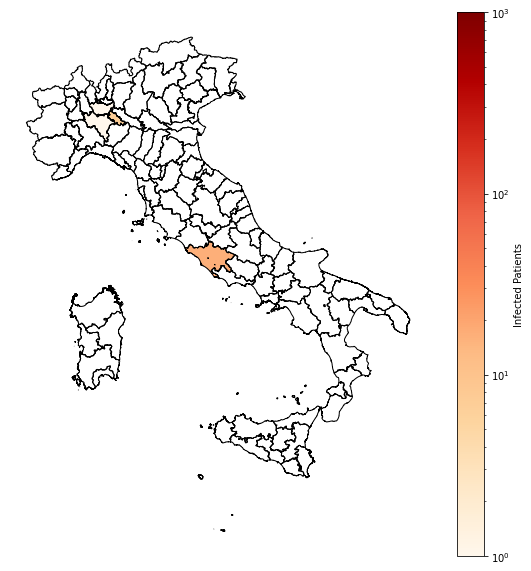

In [30]:
COLOR = 'black'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR
plt.rcParams['font.size'] = 10
plt.rcParams['legend.fontsize'] = 'large'

fig, ax= plt.subplots(figsize=(10,10))

provincial_data.geometry.boundary.plot(
    ax=ax,
    color='black',
    edgecolor='black',
    alpha=1,
    linewidth=1 ).set_axis_off()

data.plot(
    ax=ax, 
    column='2020-02-29', 
    norm=colors.LogNorm(vmin=1, vmax=1000),
    legend=True,
    legend_kwds={'label': "Infected Patients"},
    cmap='OrRd').set_axis_off()
plt.show()

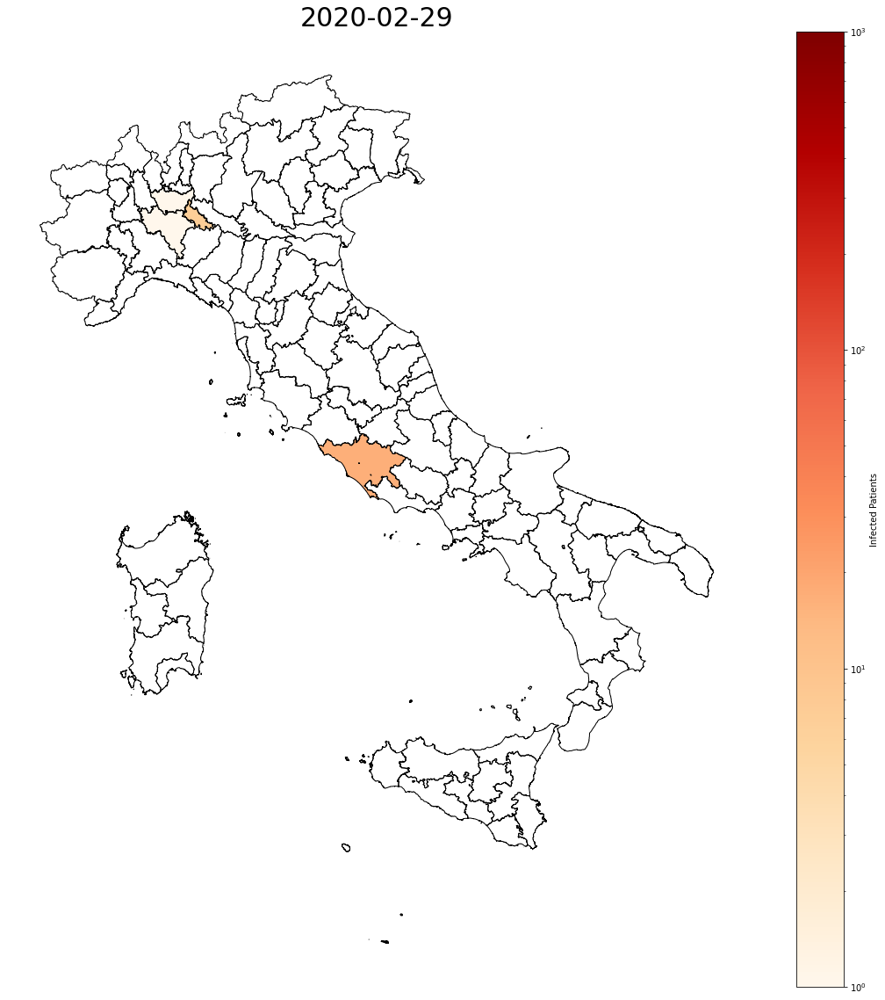

In [25]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.set_title('2020-02-29', fontsize=30)

provincial_data.geometry.boundary.plot(
            ax=ax,
            color='black',
            edgecolor='black',
            alpha=1,
            linewidth=1).set_axis_off()

data.plot(
            ax=ax, 
            column='2020-02-29', 
            norm=colors.LogNorm(vmin=1, vmax=1000),
            legend=True,
            legend_kwds={'label': "Infected Patients"},
            cmap='OrRd')



<ipython-input-15-3109060ffdc1>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(20, 20))
<ipython-input-15-3109060ffdc1>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(20, 20))
<ipython-input-15-3109060ffdc1>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  

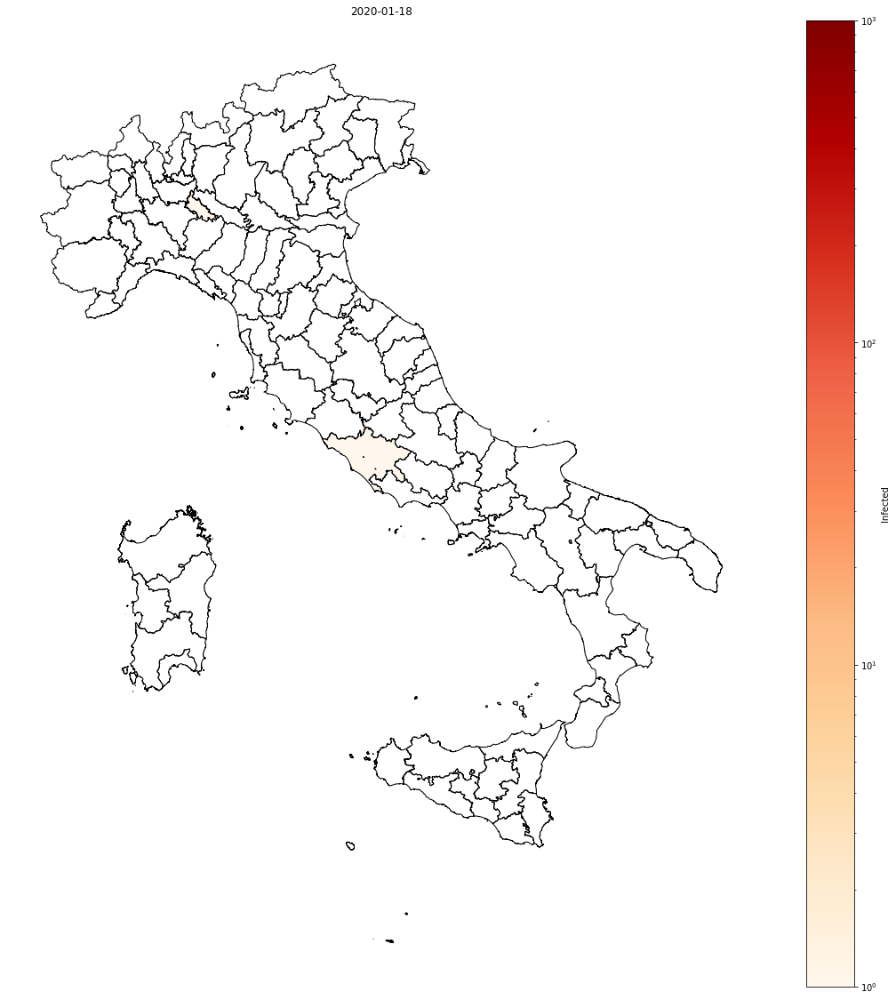

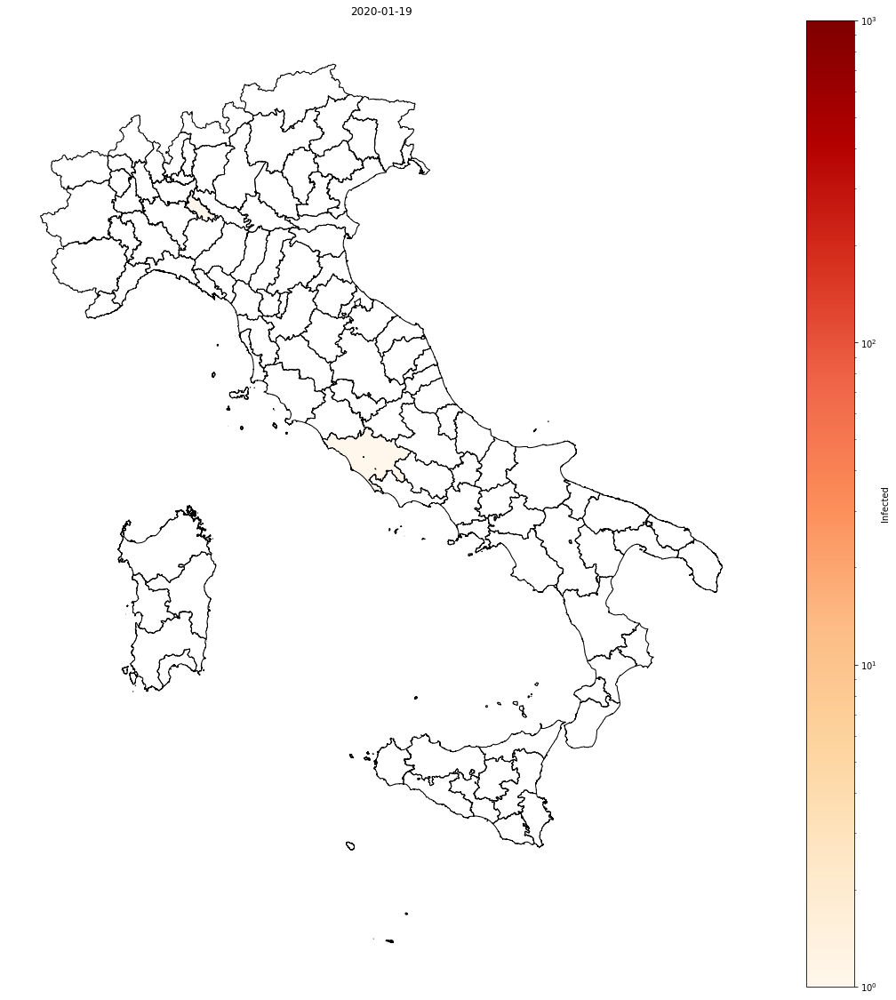

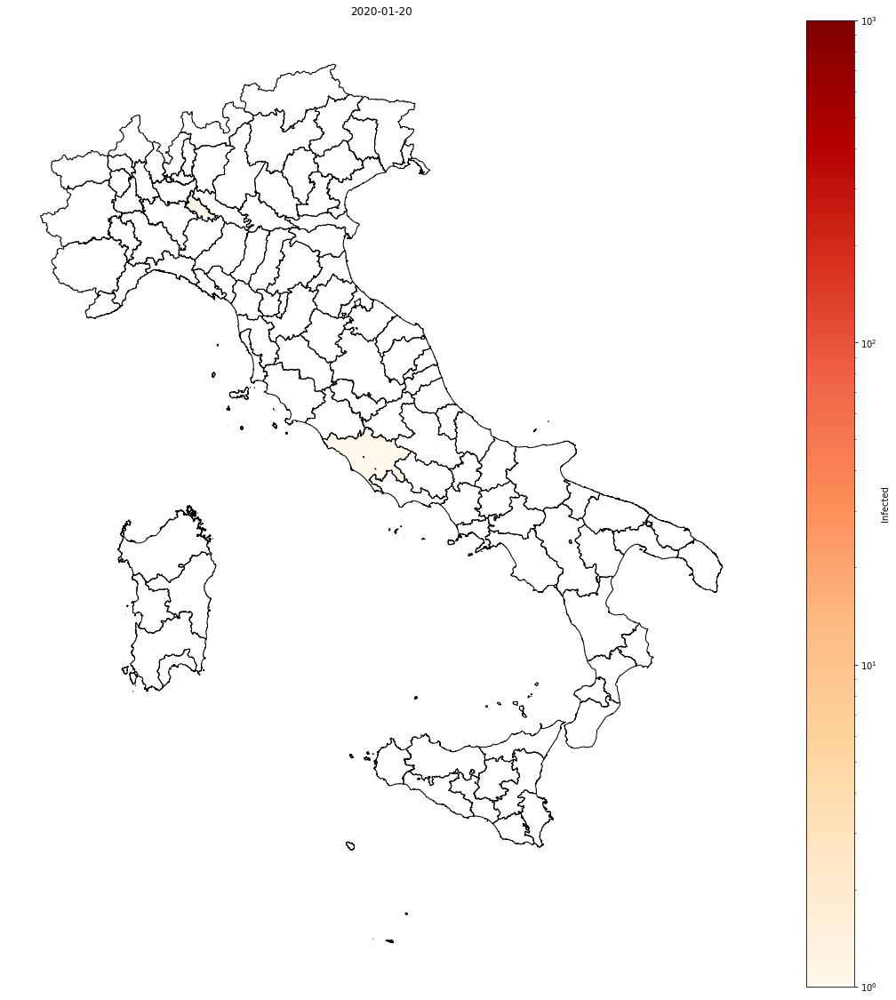

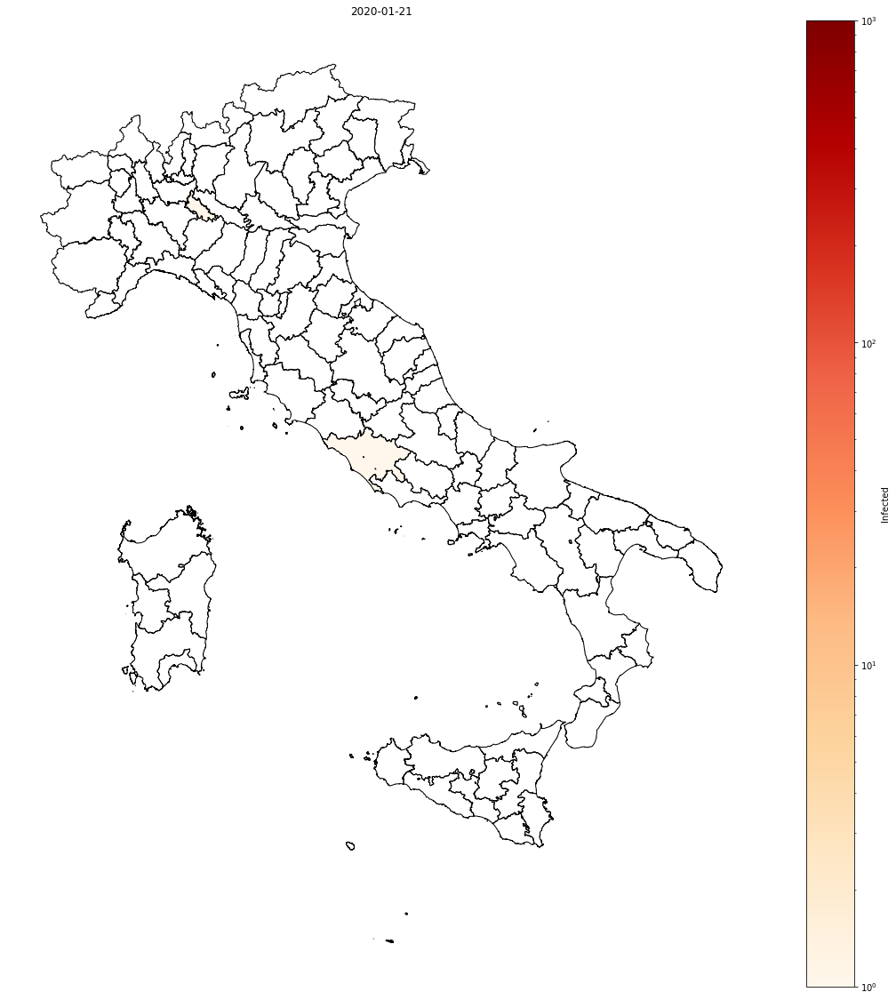

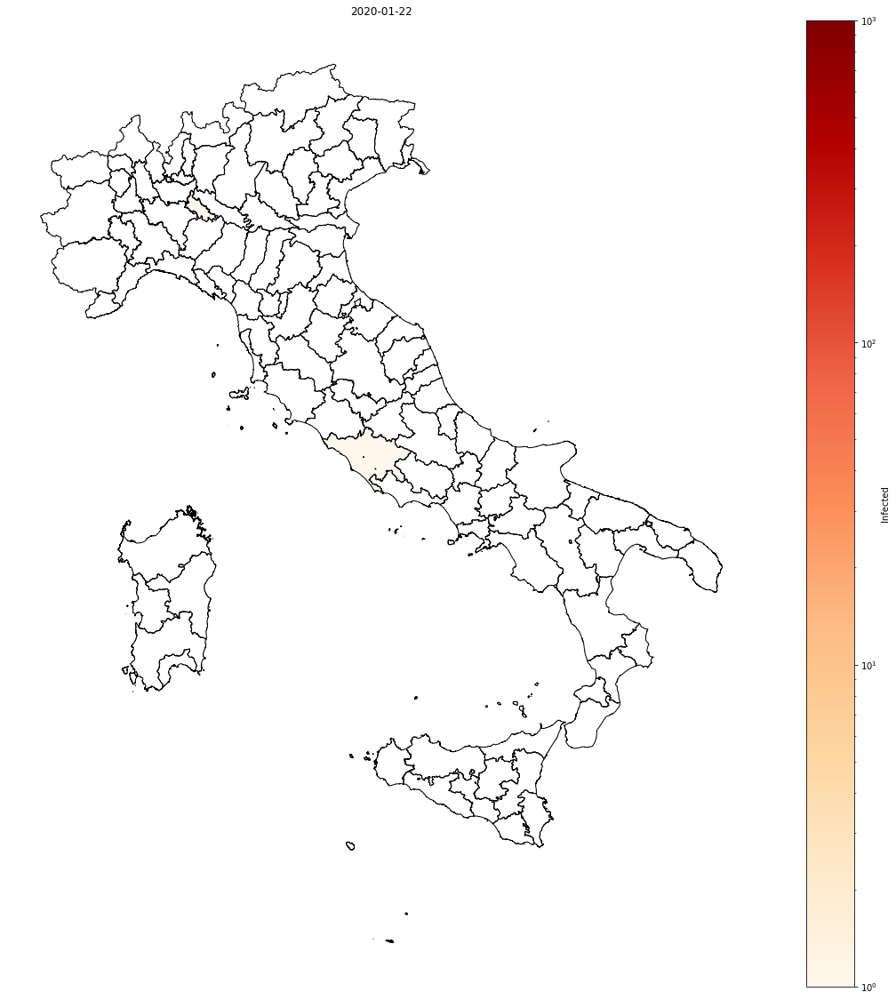

...

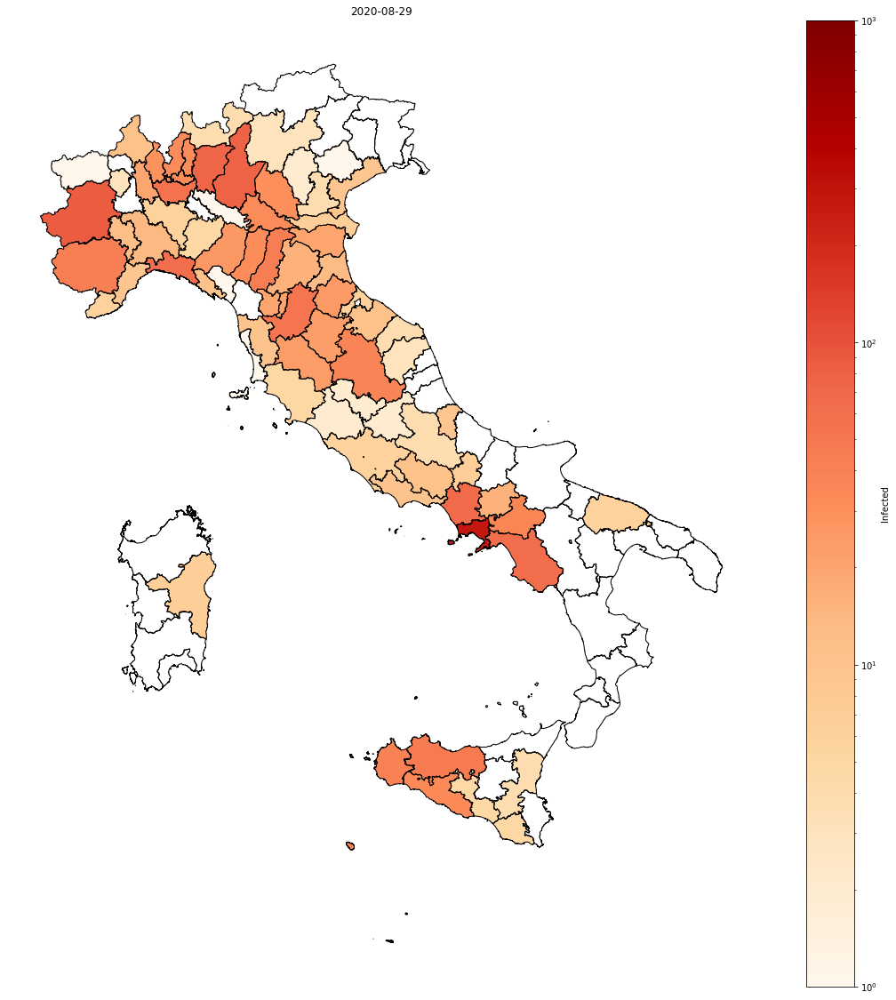

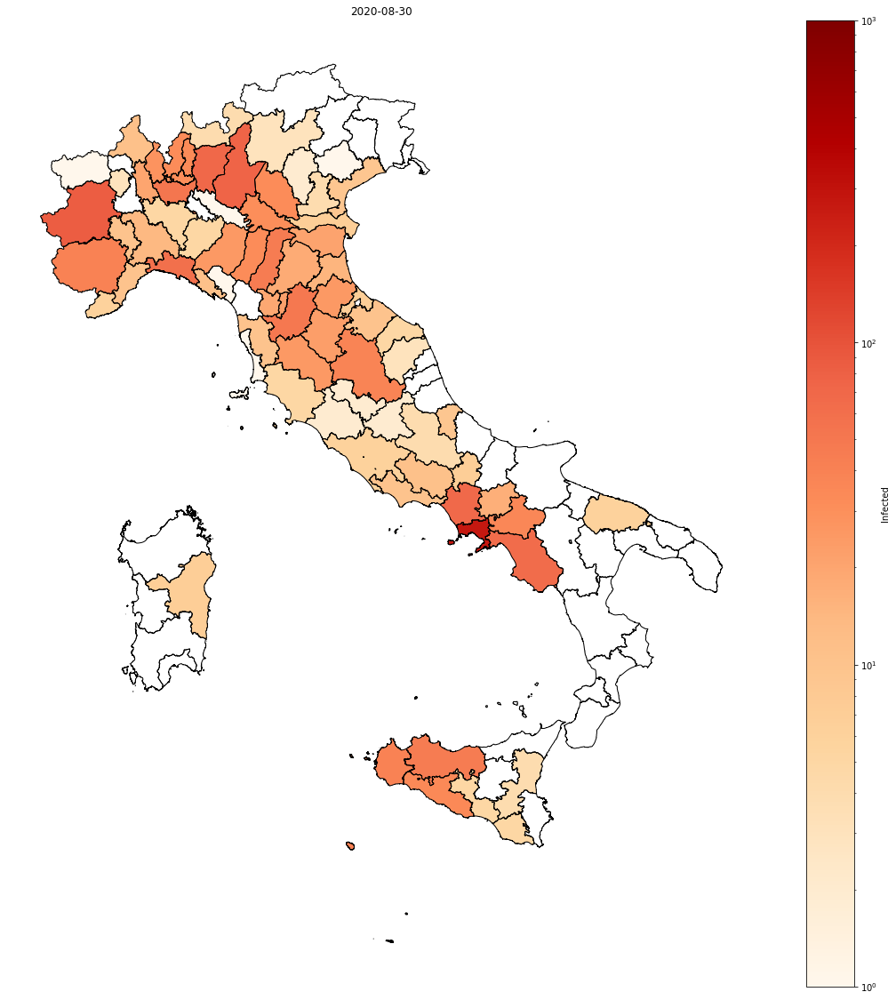

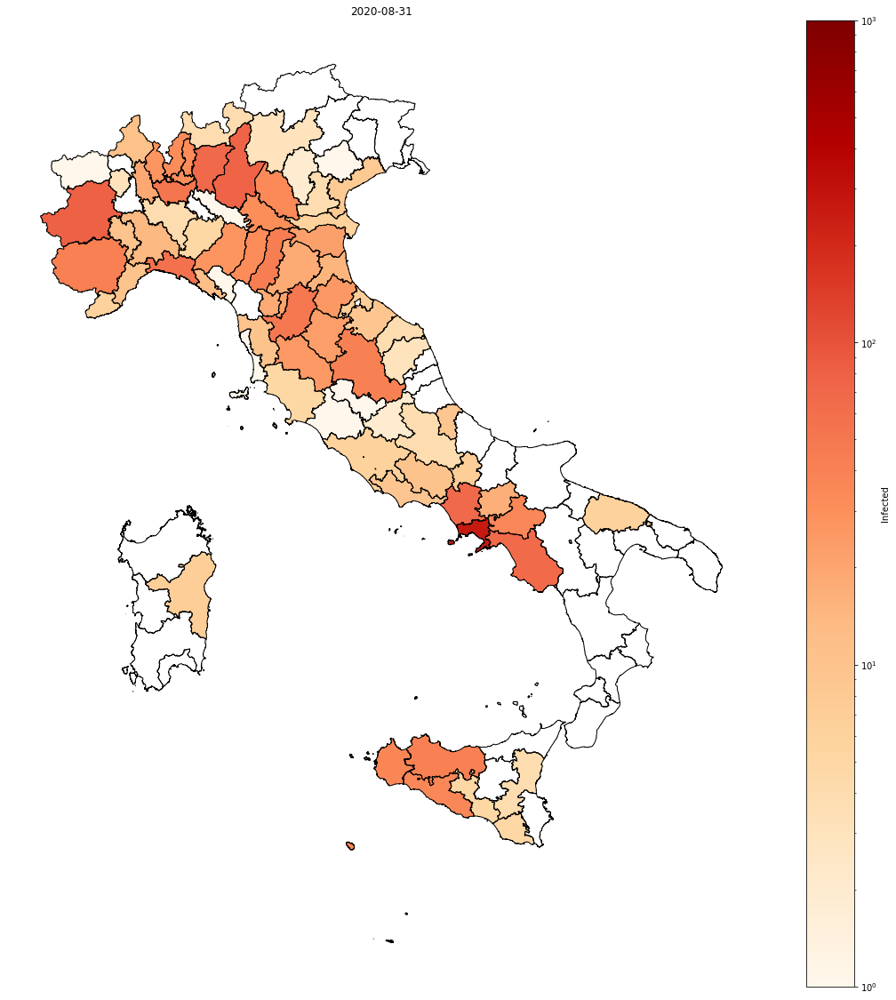

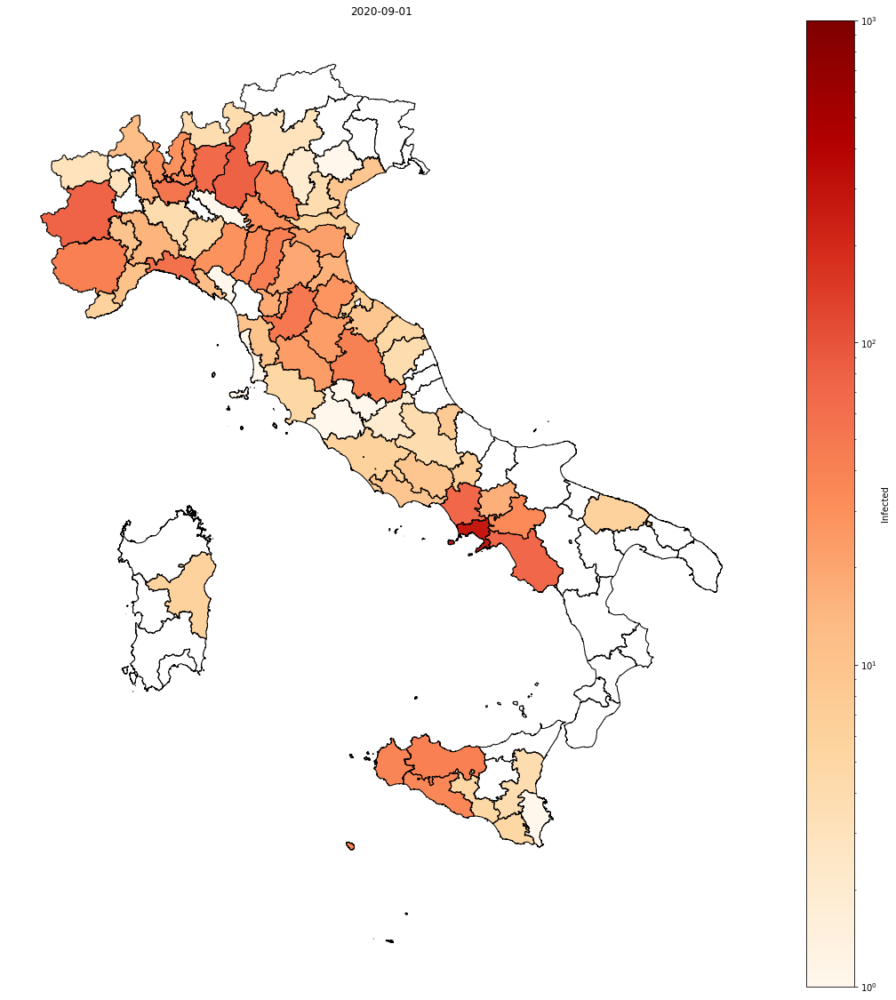

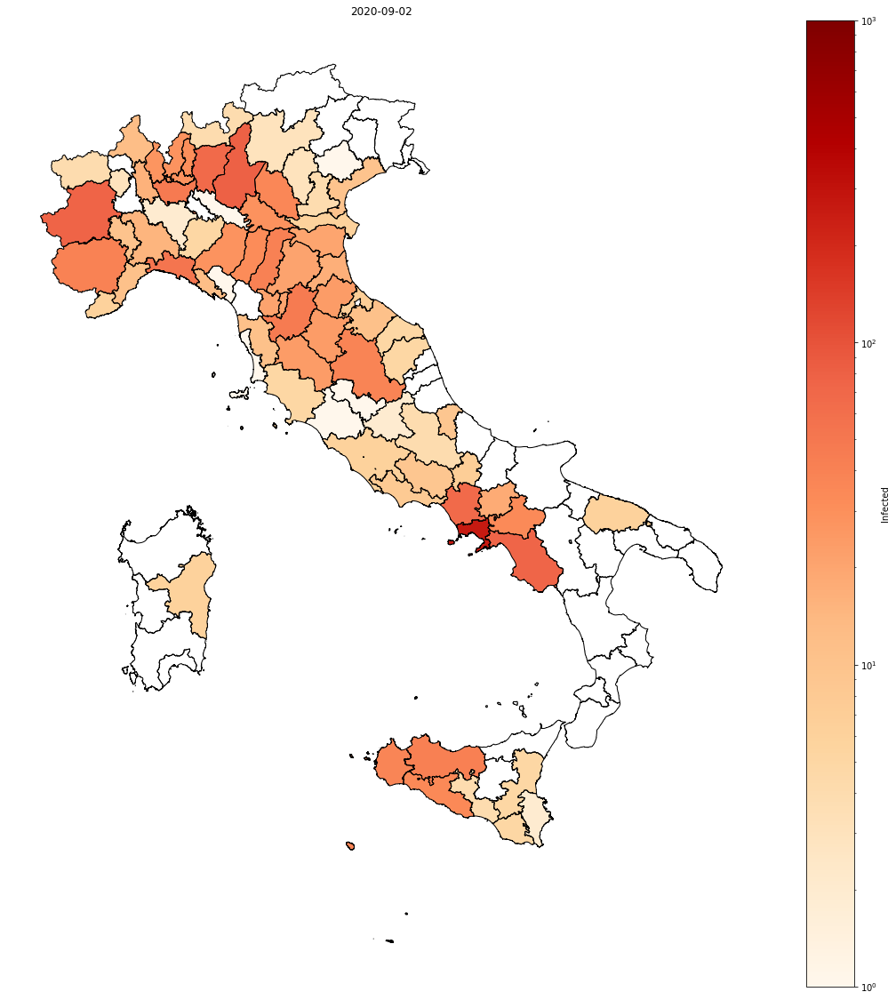

In [15]:
cols= list(data.columns)
i=0
for d in cols[4:]:
    
        fig, ax = plt.subplots(figsize=(20, 20))

        ax.set_title(d, fontsize)
        
        provincial_data.geometry.boundary.plot(
            ax=ax,
            color='black',
            edgecolor='black',
            alpha=1,
            linewidth=1).set_axis_off()

        data.plot(
            ax=ax, 
            column=d, 
            norm=colors.LogNorm(vmin=1, vmax=1000),
            legend=True,
            legend_kwds={'label': "Infected Patients"},
            cmap='OrRd')

        i += 1
        
        fig.savefig('./Animation/' + '{0:03d}'.format(i) + '.png', facecolor='slategrey', dpi=200, bbox_inches='tight')

In [16]:
import imageio
from pathlib import Path
import pygifsicle
image_path = Path('./Animation/')

In [17]:
images = list(image_path.glob('*.png'))
image_list = []
for file_name in images:
    image_list.append(imageio.imread(file_name))

imageio.mimwrite('LockdownOn.gif', image_list)

#gif_path = '/Users/Pit/GitHub/DigitalEpidemiologyProject/Notebooks/Modelling/Julia/MetapopABM/epi.gif'
# create a new one
#optimize(gif_path, '/Users/Pit/GitHub/DigitalEpidemiologyProject/Notebooks/Modelling/Julia/MetapopABM/epi_opt.gif')

![](LockdownOff.gif)

![](LockdownOn.gif)